In [1]:
#Importing relevant libraries
import os
import pandas as pd
import cv2
#from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from patchify import patchify, unpatchify
import seaborn as sns
import random
import numpy as np
from sklearn.model_selection import train_test_split
import pickle
import tensorflow as tf
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras import models, layers
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, BatchNormalization, Activation, Flatten, Dense, Input, MaxPooling2D
from tensorflow.keras.activations import softmax
from tensorflow.keras import initializers, regularizers
from tensorflow.keras.optimizers import Adam
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim
%load_ext tensorboard

In [2]:
dir = os.listdir('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data')
folders=[]
for folder in dir:
  folders.append(folder)
#C:\Users\girij\OneDrive\Desktop\ImageDenoising-main\SIDD_Small_sRGB_Only\Data
GT = []
Noisy = []
for folder in folders:
  files = os.listdir('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/'+folder)
  for img in files:
    if img[0]=='G':
      GT.append('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/'+folder+'/'+img)
    else:
      Noisy.append('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/'+folder+'/'+img)

In [6]:
df = pd.DataFrame()
df['Ground Truth Images'] = GT
df['Noisy Images'] = Noisy
df.head()

,Ground Truth Images,Noisy Images
0,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
2,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
3,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
4,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...


In [7]:
df.shape

(160, 2)

In [7]:
#Merging the two datasets (SIDD and RENOIR)
'''
df = pd.concat([df_SIDD],ignore_index=True)
df = df.sample(frac = 1)
df = df.reset_index(drop=True)
df
'''

,Ground Truth Images,Noisy Images
0,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
2,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
3,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
4,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
...,...,...
155,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
156,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
157,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
158,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...


In [8]:
size=[]
for i in range(len(df)):
  img_gt = cv2.imread(df['Ground Truth Images'].iloc[i])
  size.append(img_gt.shape)

In [9]:
df['image size'] = size
df['image size'] = df['image size'].astype(str)
df.head()

,Ground Truth Images,Noisy Images,image size
0,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
2,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
3,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
4,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"


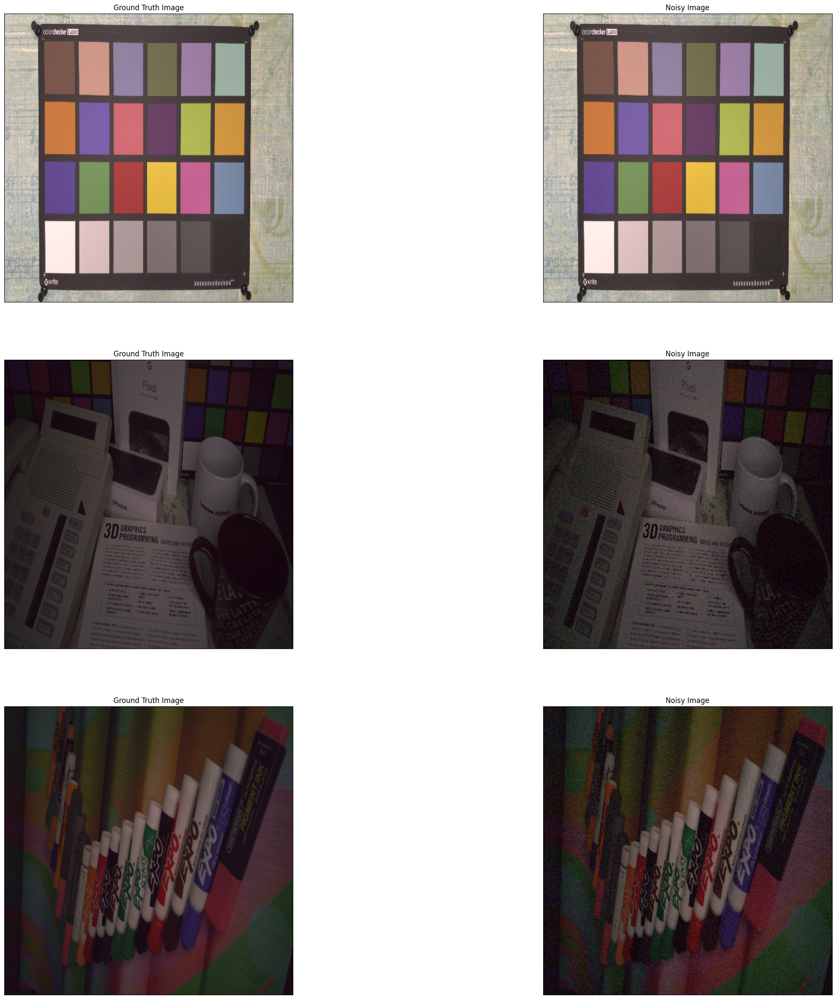

In [12]:
sample = df.sample(3)
fig, ax = plt.subplots(len(sample),2,figsize=(30,30))
for i in range(len(sample)):
  img = cv2.imread(sample['Ground Truth Images'].iloc[i])
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img,(512,512))
  ax[i][0].imshow(img)
  ax[i][0].get_xaxis().set_visible(False)
  ax[i][0].get_yaxis().set_visible(False)
  ax[i][0].title.set_text("Ground Truth Image")
  
  img = cv2.imread(sample['Noisy Images'].iloc[i])
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img,(512,512))
  ax[i][1].imshow(img)
  ax[i][1].get_xaxis().set_visible(False)
  ax[i][1].get_yaxis().set_visible(False)
  ax[i][1].title.set_text("Noisy Image")

In [13]:
X = df['Noisy Images']
y = df['Ground Truth Images']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

In [14]:
#Storing the image patches as pickle files
import pickle
pickle.dump((X_train,y_train),open('train_path.pkl','wb'))
pickle.dump((X_test,y_test),open('test_path.pkl','wb'))

In [15]:
X_train, y_train = pickle.load(open('train_path.pkl', 'rb'))
X_test,y_test = pickle.load(open('test_path.pkl', 'rb'))

In [16]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(128,)
(128,)
(32,)
(32,)


In [17]:
def patches(img,patch_size):
  patches = patchify(img, (patch_size, patch_size, 3), step=patch_size)
  return patches

In [36]:
sample = pd.DataFrame({'Ground Truth Images':['a','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0001_001_S6_00100_00060_3200_L/GT_SRGB_010.PNG'], 'Noisy Images':['b','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0001_001_S6_00100_00060_3200_L/NOISY_SRGB_010.PNG']})
sample

,Ground Truth Images,Noisy Images
0,a,b
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...


In [42]:
#Creating patches for a Ground Truth Image
path = sample['Ground Truth Images'].iloc[1]
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('Image shape: {}'.format(img.shape))

patches_gt = patches(img,256)
print('Patch shape: {}'.format(patches_gt.shape))

Image shape: (3000, 5328, 3)
Patch shape: (11, 20, 1, 256, 256, 3)


In [38]:
#Creating patches for a Noisy Image
path = sample['Noisy Images'].iloc[1]
img = cv2.imread(path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('Image shape: {}'.format(img.shape))

patches_nsy = patches(img,256)
print('Patch shape: {}'.format(patches_nsy.shape))

Image shape: (3000, 5328, 3)
Patch shape: (11, 20, 1, 256, 256, 3)


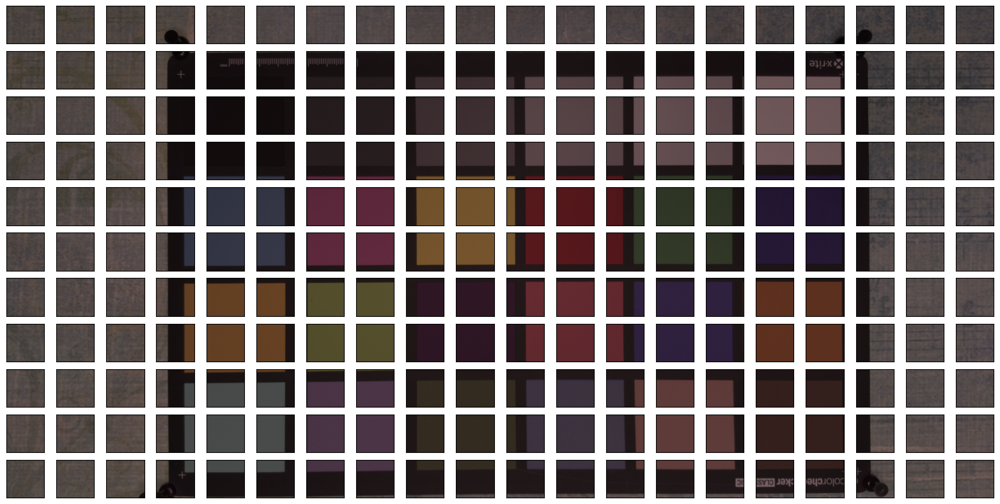

In [43]:
rows = patches_nsy.shape[0]
cols = patches_nsy.shape[1]
fig, axs = plt.subplots(rows,cols,figsize=(20,10))
for i in range(rows):
  for j in range(cols):
    axs[i][j].imshow(patches_gt[i][j][0])
    axs[i][j].get_xaxis().set_visible(False)
    axs[i][j].get_yaxis().set_visible(False)

In [177]:
#sample = df.sample(10)
#sample

,Ground Truth Images,Noisy Images,image size
9,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
37,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
73,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3044, 4048, 3)"
113,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3000, 5328, 3)"
117,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3120, 4208, 3)"
121,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3044, 4048, 3)"
72,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(2988, 5312, 3)"
50,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3024, 4032, 3)"
15,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3044, 4048, 3)"
32,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,"(3044, 4048, 3)"


In [45]:
#Creating patches for X_train and y_train
X_train_patches = []
y_train_patches = []
for i in range(len(X_train)):
  path = X_train.iloc[i]
  img_nsy = cv2.imread(path)
  img_nsy = cv2.cvtColor(img_nsy, cv2.COLOR_BGR2RGB)
  img_nsy = cv2.resize(img_nsy,(1024,1024))  #resizing the X_train images
  patches_nsy = patches(img_nsy,256)
  
  path = y_train.iloc[i]
  img_gt = cv2.imread(path)
  img_gt = cv2.cvtColor(img_gt, cv2.COLOR_BGR2RGB)
  img_gt = cv2.resize(img_gt,(1024,1024))  #resizing the y_train images
  patches_gt = patches(img_gt,256)

  rows = patches_nsy.shape[0]
  cols = patches_nsy.shape[1]
  for j in range(rows):
    for k in range(cols):
      X_train_patches.append(patches_nsy[j][k][0])
      y_train_patches.append(patches_gt[j][k][0])
  
X_train = np.array(X_train_patches)
y_train = np.array(y_train_patches)

In [46]:
#Creating patches for X_test and y_test
X_test_patches = []
y_test_patches = []
for i in range(len(X_test)):
  path = X_test.iloc[i]
  img_nsy = cv2.imread(path)
  img_nsy = cv2.cvtColor(img_nsy, cv2.COLOR_BGR2RGB)
  img_nsy = cv2.resize(img_nsy,(1024,1024))  #resizing the X_test images
  patches_nsy = patches(img_nsy,256)
  
  path = y_test.iloc[i]
  img_gt = cv2.imread(path)
  img_gt = cv2.cvtColor(img_gt, cv2.COLOR_BGR2RGB)
  img_gt = cv2.resize(img_gt,(1024,1024))  #resizing the y_test images
  patches_gt = patches(img_gt,256)

  rows = patches_nsy.shape[0]
  cols = patches_nsy.shape[1]
  for j in range(rows):
    for k in range(cols):
      X_test_patches.append(patches_nsy[j][k][0])
      y_test_patches.append(patches_gt[j][k][0])

X_test = np.array(X_test_patches)
y_test = np.array(y_test_patches)

In [47]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(2048, 256, 256, 3)
(2048, 256, 256, 3)
(512, 256, 256, 3)
(512, 256, 256, 3)


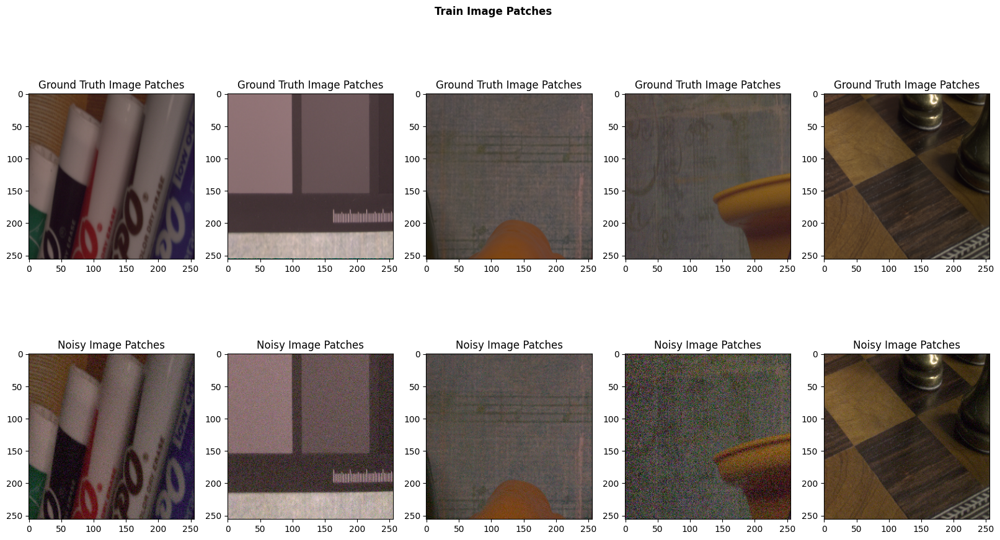

In [53]:
fig, axs = plt.subplots(2,5,figsize=(20,10))
r = random.sample(range(0, 2047), 5)

fig.suptitle('Train Image Patches',fontweight ="bold")
for i in range(5):
  axs[0][i].imshow(y_train[r[i]])
  axs[0][i].set_title('Ground Truth Image Patches')
  axs[1][i].imshow(X_train[r[i]])
  axs[1][i].set_title('Noisy Image Patches')

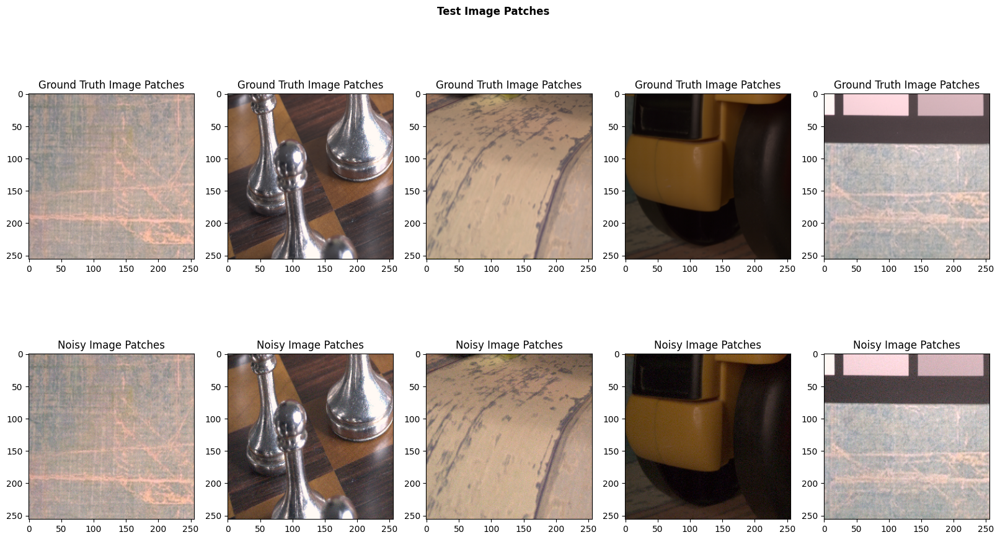

In [55]:
fig, axs = plt.subplots(2,5,figsize=(20,10))
r = random.sample(range(0, 511), 5)

fig.suptitle('Test Image Patches',fontweight ="bold")
for i in range(5):
  axs[0][i].imshow(y_test[r[i]])
  axs[0][i].set_title('Ground Truth Image Patches')
  axs[1][i].imshow(X_test[r[i]])
  axs[1][i].set_title('Noisy Image Patches')

In [56]:
print("Total number of image patches on train data : ", len(X_train))
print("Total number of image patches on test data : ", len(X_test))

Total number of image patches on train data :  2048
Total number of image patches on test data :  512


In [57]:
#Storing the image patches as pickle files
import pickle
pickle.dump((X_train,y_train),open('train_data.pkl','wb'))
pickle.dump((X_test,y_test),open('test_data.pkl','wb'))

In [58]:
mean_red_gt = []
mean_blue_gt = []
mean_green_gt = []
mean_red_nsy = []
mean_blue_nsy = []
mean_green_nsy = []
for path in df['Ground Truth Images']:
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  mean_red_gt.append(np.mean(img[:,:,0]))
  mean_green_gt.append(np.mean(img[:,:,1]))
  mean_blue_gt.append(np.mean(img[:,:,2]))

for path in df['Noisy Images']:
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  mean_red_nsy.append(np.mean(img[:,:,0]))
  mean_green_nsy.append(np.mean(img[:,:,1]))
  mean_blue_nsy.append(np.mean(img[:,:,2]))

In [59]:
red_gt = pd.DataFrame()
green_gt = pd.DataFrame()
blue_gt = pd.DataFrame()
red_nsy = pd.DataFrame()
green_nsy = pd.DataFrame()
blue_nsy = pd.DataFrame()

red_gt['Mean Pixel on Ground Truth Images'] = mean_red_gt
red_gt['channel'] = 'red'
red_nsy['Mean Pixel on  Noisy Images'] = mean_red_nsy
red_nsy['channel'] = 'red'

green_gt['Mean Pixel on Ground Truth Images'] = mean_green_gt
green_gt['channel'] = 'green'
green_nsy['Mean Pixel on  Noisy Images'] = mean_green_nsy
green_nsy['channel'] = 'green'

blue_gt['Mean Pixel on Ground Truth Images'] = mean_blue_gt
blue_gt['channel'] = 'blue'
blue_nsy['Mean Pixel on  Noisy Images'] = mean_blue_nsy
blue_nsy['channel'] = 'blue'

concat_gt = pd.concat([red_gt,green_gt,blue_gt],ignore_index=True)
concat_nsy = pd.concat([red_nsy,green_nsy,blue_nsy],ignore_index=True)

In [71]:
sample = pd.DataFrame({'Ground Truth Images' : ['C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0017_001_GP_00100_00060_5500_N/GT_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0019_001_GP_00800_00640_5500_L/GT_SRGB_010.PNG'], 'Noisy Images' : ['C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0017_001_GP_00100_00060_5500_N/NOISY_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0019_001_GP_00800_00640_5500_L/NOISY_SRGB_010.PNG']})
sample

,Ground Truth Images,Noisy Images
0,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...


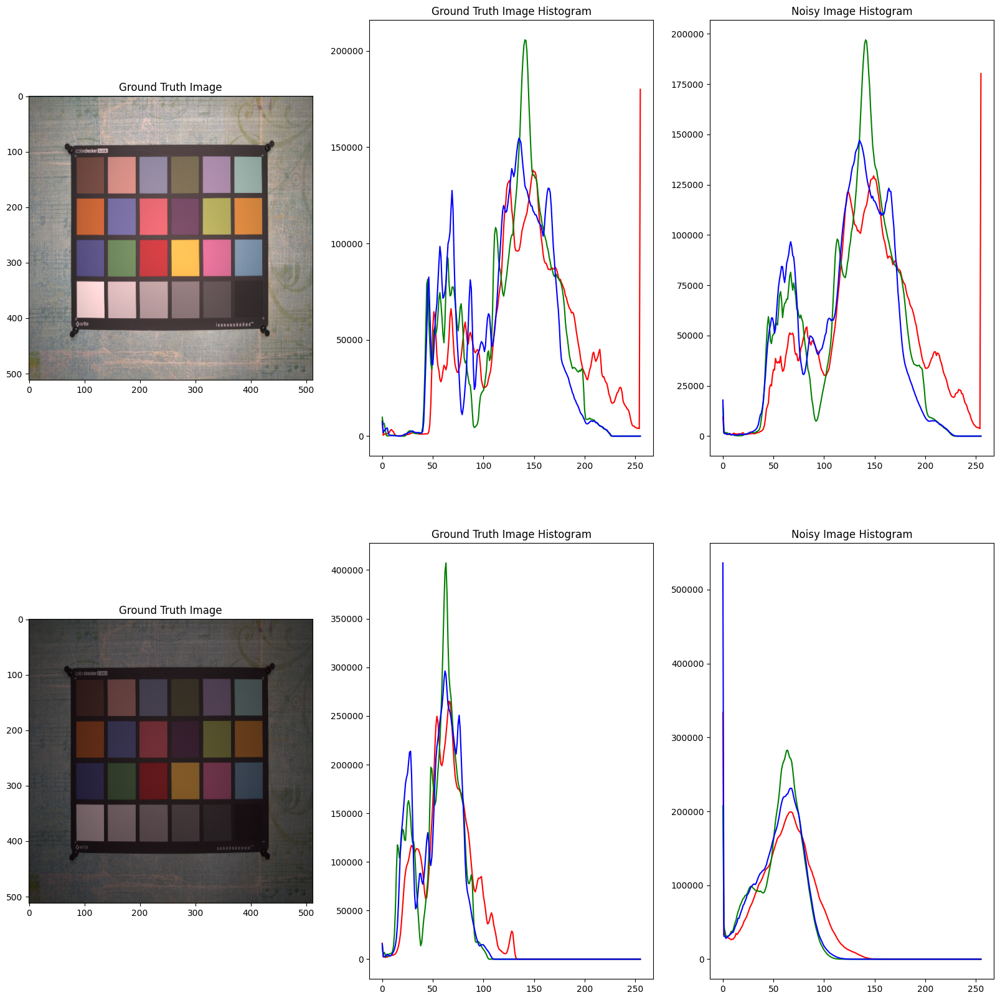

In [72]:
#https://www.geeksforgeeks.org/opencv-python-program-analyze-image-using-histogram/
fig, axes = plt.subplots(len(sample),3,figsize=(20, 20))
for i in range(len(sample)):
  path = sample['Ground Truth Images'].iloc[i]
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  resized_img = cv2.resize(img,(512,512))
  axes[i][0].imshow(resized_img)
  axes[i][0].set_title('Ground Truth Image')
  axes[i][1].plot(cv2.calcHist([img],[0],None,[256],[0,256]),color='r')
  axes[i][1].plot(cv2.calcHist([img],[1],None,[256],[0,256]),color='g')
  axes[i][1].plot(cv2.calcHist([img],[2],None,[256],[0,256]),color='b')
  axes[i][1].set_title('Ground Truth Image Histogram')

  path = sample['Noisy Images'].iloc[i]
  img = cv2.imread(path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  axes[i][2].plot(cv2.calcHist([img],[0],None,[256],[0,256]),color='r')
  axes[i][2].plot(cv2.calcHist([img],[1],None,[256],[0,256]),color='g')
  axes[i][2].plot(cv2.calcHist([img],[2],None,[256],[0,256]),color='b')
  axes[i][2].set_title('Noisy Image Histogram')

In [90]:
from tqdm import tqdm
SSIM = []
PSNR = []
for i in tqdm(range(len(df))):
  path = df['Ground Truth Images'].iloc[i]
  img1 = cv2.imread(path)
  img1 = img1.astype("float32") / 255.0
  path = df['Noisy Images'].iloc[i]
  img2 = cv2.imread(path)
  img2 = img2.astype("float32") / 255.0
  SSIM.append(ssim(img1,img2,multichannel=True,data_range=img2.max() - img2.min(),win_size=3))
  PSNR.append(psnr(img1,img2))

100%|██████████| 160/160 [18:42<00:00,  7.01s/it]


In [81]:
sample

,Ground Truth Images,Noisy Images
0,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...
1,C:/Users/girij/OneDrive/Desktop/ImageDenoising...,C:/Users/girij/OneDrive/Desktop/ImageDenoising...


In [97]:
improvement = [x1 - x2 for (x1, x2) in zip(PSNR_de_nsy, PSNR_nsy)]

In [114]:
from prettytable import PrettyTable
x = PrettyTable()
x.add_column("PSNR before denoising",PSNR_nsy)
x.add_column("PSNR after denoising",PSNR_de_nsy)
x.add_column("PSNR Improvement",improvement)
print(x)

+-----------------------+----------------------+---------------------+
| PSNR before denoising | PSNR after denoising |   PSNR Improvement  |
+-----------------------+----------------------+---------------------+
|   29.350393860373458  |  26.439435839022543  | -2.9109580213509147 |
|   30.837561449365207  |  26.96319798235695   | -3.8743634670082585 |
+-----------------------+----------------------+---------------------+


In [100]:
X_train_patches, y_train_patches = pickle.load(open('train_data.pkl', 'rb'))
X_test_patches,y_test_patches = pickle.load(open('test_data.pkl', 'rb'))

In [101]:
print(X_train_patches.shape)
print(y_train_patches.shape)
print(X_test_patches.shape)
print(y_test_patches.shape)

(2048, 256, 256, 3)
(2048, 256, 256, 3)
(512, 256, 256, 3)
(512, 256, 256, 3)


In [102]:
#Normalizing the image pixels
X_train_patches = X_train_patches.astype("float32") / 255.0
y_train_patches = y_train_patches.astype("float32") / 255.0
X_test_patches = X_test_patches.astype("float32") / 255.0
y_test_patches = y_test_patches.astype("float32") / 255.0

In [103]:
class Dataloder(tf.keras.utils.Sequence):    
    def __init__(self, X,y,batch_size=1, shuffle=False):
        self.X = X
        self.y = y
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.indexes = np.arange(len(X))

    def __getitem__(self, i):
        # collect batch data
        batch_x = self.X[i * self.batch_size : (i+1) * self.batch_size]
        batch_y = self.y[i * self.batch_size : (i+1) * self.batch_size]
        
        return tuple((batch_x,batch_y))
    
    def __len__(self):
        return len(self.indexes) // self.batch_size
    
    def on_epoch_end(self):
        if self.shuffle:
            self.indexes = np.random.permutation(self.indexes)

In [104]:
batch_size=32
train_dataloader = Dataloder(X_train_patches,y_train_patches, batch_size, shuffle=True)
test_dataloader = Dataloder(X_test_patches,y_test_patches,batch_size, shuffle=True)

In [105]:
train_dataloader[0][0].shape

(32, 256, 256, 3)

In [192]:
#Custom function to get denoised image prediction for noisy images
def prediction(img,model):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img,(1024,1024))
  img = img.astype("float32") / 255.0

  img_patches = patches(img,256)

  nsy=[]
  for i in range(4):
    for j in range(4):
      nsy.append(img_patches[i][j][0])
  nsy = np.array(nsy)

  pred_img = model.predict(nsy)
  pred_img = np.reshape(pred_img,(4,4,1,256,256,3))
  pred_img = unpatchify(pred_img, img.shape)
  return pred_img

In [193]:
#Custom function to get denoised image prediction for noisy images on quantized models using tflite
def prediction_tflite(img,model):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  img = cv2.resize(img,(1024,1024))
  img = img.astype("float32") / 255.0

  img_patches = patches(img,256)

  nsy=[]
  for i in range(4):
    for j in range(4):
      nsy.append(img_patches[i][j][0])
  nsy = np.array(nsy)
  pred=[]
  for patch in nsy:
    model.set_tensor(input_details[0]['index'], tf.expand_dims(patch,axis=0))
    model.invoke()
    tflite_model_predictions = model.get_tensor(output_details[0]['index'])
    pred.append(tflite_model_predictions)

  pred_img = np.reshape(pred,(4,4,1,256,256,3))
  pred_img = unpatchify(pred_img, img.shape)
  return pred_img

In [194]:
#Custom function to plot/visualize noisy, ground truth and predicted images
def visualize(sample,model):
  fig,ax = plt.subplots(len(sample),3,figsize=(30,30))
  for i in range(len(sample)):
    path = sample['Ground Truth Images'].iloc[i]
    test_img_gt = cv2.imread(path)
    test_img_gt = cv2.cvtColor(test_img_gt, cv2.COLOR_BGR2RGB)
    test_img_gt = cv2.resize(test_img_gt,(512,512))
    test_img_gt = test_img_gt.astype("float32") / 255.0
  
    path = sample['Noisy Images'].iloc[i]
    test_img_nsy = cv2.imread(path)
    pred_img = prediction(test_img_nsy,model)
    pred_img = cv2.resize(pred_img,(512,512))

    test_img_nsy = cv2.cvtColor(test_img_nsy, cv2.COLOR_BGR2RGB)
    test_img_nsy = cv2.resize(test_img_nsy,(512,512))
    test_img_nsy = test_img_nsy.astype("float32") / 255.0
    
    ax[i][0].imshow(test_img_nsy)
    ax[i][0].get_xaxis().set_visible(False)
    ax[i][0].get_yaxis().set_visible(False)
    ax[i][0].title.set_text("Noisy Image")

    ax[i][1].imshow(test_img_gt)
    ax[i][1].get_xaxis().set_visible(False)
    ax[i][1].get_yaxis().set_visible(False)
    ax[i][1].title.set_text("Ground Truth Image")

    ax[i][2].imshow(pred_img)
    ax[i][2].get_xaxis().set_visible(False)
    ax[i][2].get_yaxis().set_visible(False)
    ax[i][2].title.set_text("Predicted Image")

In [195]:
#Custom function that computes the psnr and ssim values for images
def psnr_and_ssim(X_test,y_test,model,model_type='Normal'):
  psnr_nsy = 0.0
  psnr_de_nsy = 0.0
  ssim_nsy = 0.0
  ssim_de_nsy = 0.0
  for i in range(len(X_test)):
    #getting the noisy images
    path = X_test.iloc[i]
    nsy = cv2.imread(path)  

    #getting the predicted images
    if model_type == 'Quantized': 
      pred = prediction_tflite(nsy,model)
    else:
      pred = prediction(nsy,model)

    #getting the ground truth images
    path = y_test[i]
    gt = cv2.imread(str(path))         
    gt = cv2.cvtColor(gt, cv2.COLOR_BGR2RGB)
    
    #Resizing the images
    gt = cv2.resize(gt,(1024,1024))
    nsy = cv2.resize(nsy,(1024,1024))

    #Normalizing the images
    gt = gt.astype("float32") / 255.0
    nsy = nsy.astype("float32") / 255.0

    #Computing psnr and ssim for test images
    psnr_nsy += psnr(gt,nsy)
    psnr_de_nsy += psnr(gt,pred)
    ssim_nsy += ssim(gt,nsy,multichannel=True,data_range=nsy.max() - nsy.min())
    ssim_de_nsy += ssim(gt,pred,multichannel=True,data_range=pred.max() - pred.min())

  psnr_nsy = psnr_nsy/len(X_test)
  psnr_de_nsy = psnr_de_nsy/len(X_test)
  ssim_nsy = ssim_nsy/len(X_test)
  ssim_de_nsy = ssim_de_nsy/len(X_test)
  return psnr_nsy, psnr_de_nsy,ssim_nsy,ssim_de_nsy

In [196]:
#https://keras.io/examples/vision/autoencoder/
tf.keras.backend.clear_session()
input = Input(shape=(256, 256, 3))

# Encoder
x = Conv2D(32, (3, 3), activation="relu", kernel_initializer='he_normal',padding="same")(input)
x = MaxPooling2D((2, 2), padding="same")(x)
x = Conv2D(64, (3, 3), activation="relu", kernel_initializer='he_normal',padding="same")(x)
x = MaxPooling2D((2, 2), padding="same")(x)
x = Conv2D(128, (3, 3), activation="relu", kernel_initializer='he_normal',padding="same")(x)
x = MaxPooling2D((2, 2), padding="same")(x)

# Decoder
x = Conv2DTranspose(128, (3, 3), strides=2, activation="relu", kernel_initializer='he_normal',padding="same")(x)
x = Conv2DTranspose(64, (3, 3), strides=2, activation="relu",kernel_initializer='he_normal', padding="same")(x)
x = Conv2DTranspose(32, (3, 3), strides=2, activation="relu", kernel_initializer='he_normal',padding="same")(x)
x = Conv2D(3, (3, 3), activation="sigmoid", kernel_initializer='he_normal',padding="same")(x)

# Autoencoder
autoencoder = Model(input, x)
autoencoder.compile(optimizer=tf.keras.optimizers.Adam(1e-03), loss=tf.keras.losses.MeanSquaredError())
autoencoder.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 256, 256, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 128, 128, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 128, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 64, 64, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 64, 64, 128)       73856 

In [115]:
log_dir="logs/model_1"
tensorboard = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1, write_graph=True,write_grads=True)
reducelr = ReduceLROnPlateau(monitor='val_loss', factor=0.1,verbose=1,patience=2)
callback = [tensorboard,reducelr]
autoencoder.fit(train_dataloader,shuffle=True,epochs=15,validation_data= test_dataloader, callbacks=callback)

Epoch 1/15
64/64 [==============================] - 347s 5s/step - loss: 0.0281 - val_loss: 0.0210 - lr: 0.0010
Epoch 2/15
64/64 [==============================] - 342s 5s/step - loss: 0.0173 - val_loss: 0.0158 - lr: 0.0010
Epoch 3/15
64/64 [==============================] - 336s 5s/step - loss: 0.0086 - val_loss: 0.0063 - lr: 0.0010
Epoch 4/15
64/64 [==============================] - 342s 5s/step - loss: 0.0037 - val_loss: 0.0031 - lr: 0.0010
Epoch 5/15
64/64 [==============================] - 339s 5s/step - loss: 0.0027 - val_loss: 0.0026 - lr: 0.0010
Epoch 6/15
64/64 [==============================] - 339s 5s/step - loss: 0.0024 - val_loss: 0.0023 - lr: 0.0010
Epoch 7/15
64/64 [==============================] - 339s 5s/step - loss: 0.0022 - val_loss: 0.0022 - lr: 0.0010
Epoch 8/15
64/64 [==============================] - 483s 8s/step - loss: 0.0020 - val_loss: 0.0022 - lr: 0.0010
Epoch 9/15
64/64 [==============================] - ETA: 0s - loss: 0.0025
Epoch 9: ReduceLROnPlateau re

In [ ]:
%tensorboard --logdir "/content/logs/model_1"

In [117]:
autoencoder.save('autoencoder.h5')

c:\Users\girij\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [119]:
autoencoder =  tf.keras.models.load_model('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/autoencoder.h5')

In [125]:
sample = pd.DataFrame({'Ground Truth Images' : ['C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0001_001_S6_00100_00060_3200_L/GT_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0017_001_GP_00100_00060_5500_N/GT_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0189_008_IP_00400_00400_3200_N/GT_SRGB_010.PNG'], 'Noisy Images' : ['C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0001_001_S6_00100_00060_3200_L/NOISY_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0017_001_GP_00100_00060_5500_N/NOISY_SRGB_010.PNG','C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/SIDD_Small_sRGB_Only/Data/0189_008_IP_00400_00400_3200_N/NOISY_SRGB_010.PNG']})


1/1 [==============================] - 1s 554ms/step


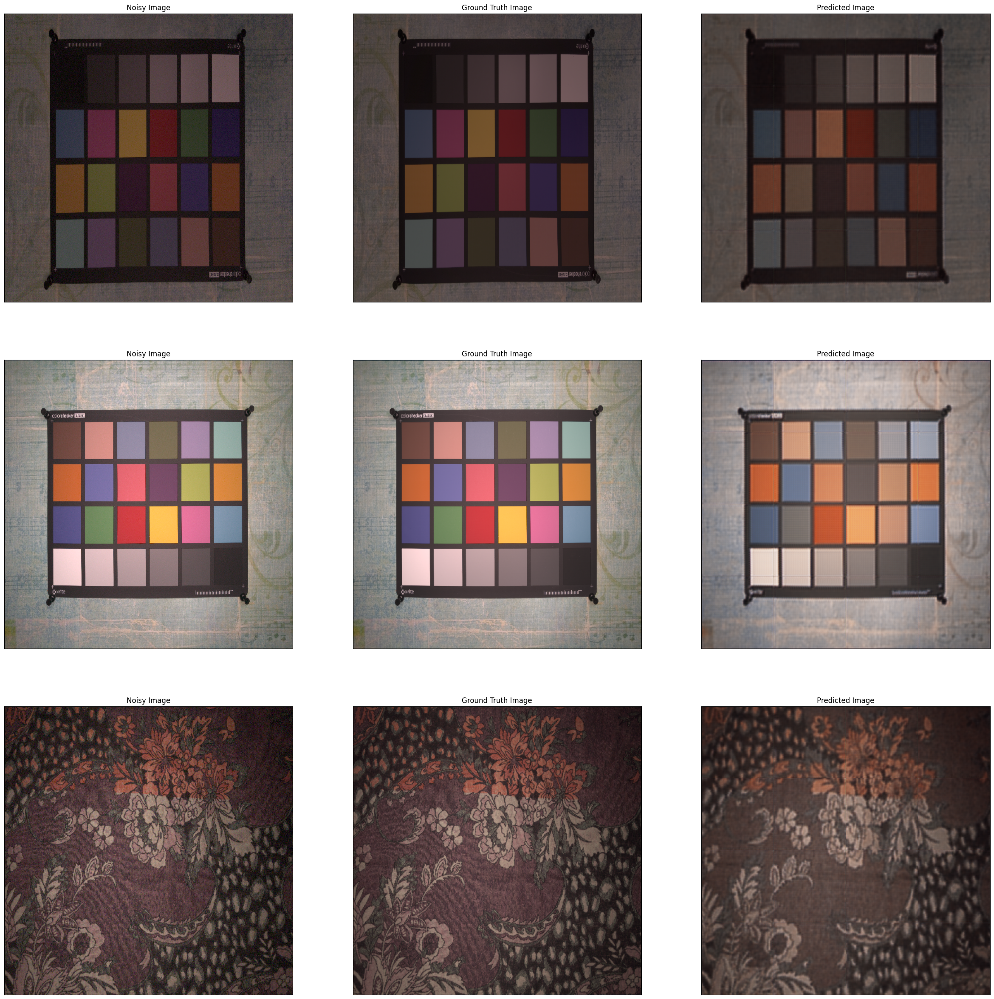

In [126]:
visualize(sample,autoencoder)

In [2]:
RIDNet = tf.keras.models.load_model('C:/Users/girij/OneDrive/Desktop/ImageDenoising-main/RIDNet.h5')

In [1]:
from prettytable import PrettyTable
x = PrettyTable()
x.add_column("Model", ['Autoencoder Original Model','Autoencoder Quantized Model'])
x.add_column('Average PSNR on test images',['36.595','36.619'])
x.add_column('Average SSIM on test images',['0.881','0.879'])
x.add_column('Model size in MB',['20.956','6.877'])
print(x)


+-----------------------------+-----------------------------+-----------------------------+------------------+
|            Model            | Average PSNR on test images | Average SSIM on test images | Model size in MB |
+-----------------------------+-----------------------------+-----------------------------+------------------+
|  Autoencoder Original Model |            36.595           |            0.881            |      20.956      |
| Autoencoder Quantized Model |            36.619           |            0.879            |      6.877       |
+-----------------------------+-----------------------------+-----------------------------+------------------+
